<a href="https://colab.research.google.com/github/juanfrans-courses/threads-storytelling-with-maps-and-data/blob/main/05_Spatial_Operations/Spatial_Operations_Part_3_Buffers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Spatial Operations Part 3 - Buffers

In this notebook, we will reproduce (correctly) this piece by [The Economist](https://www.economist.com/asia/2003/05/15/correction-north-koreas-missiles). In doing so, you will learn how to correctly create buffers, and how to properly manage coordinate reference systems in the process.

![Flat-earth thinking](https://www.independent.com/wp-content/uploads/2017/06/14/Economist_dual_maps.jpg)

## Importing libraries

First, of course, we import our usual libraries. However, note that before installing `geopandas` we are also installing `rtree`. [Rtree](https://rtree.readthedocs.io/en/latest/) is a library that allows Geopandas to create spatial indices, and thus perform spatial operations such as buffers.

In [ ]:
import pandas as pd
import numpy as np
import geopandas as gpd
import altair as alt

## Loading and creating base data

Next, we will load a world countries file from Natural Earth, and create a simple dataframe with the geographic coordinates for Pyongyan, North Korea's capital. Since we don't know the exact location of the missile launching sites we will use Pyongyang's coordinates.

In [ ]:
countries = gpd.read_file('https://naciscdn.org/naturalearth/110m/cultural/ne_110m_admin_0_countries.zip')

In [ ]:
pyongyang = pd.DataFrame({'city': ['Pyongyang'], 'country': ["Democratic People's Republic of Korea"], 'longitude': [125.7552106631059], 'latitude': [39.038430756002995]})

In [ ]:
pyongyang.head()

,city,country,longitude,latitude
0,Pyongyang,Democratic People's Republic of Korea,125.755211,39.038431


Let's convert the basic dataframe into a `GeoDataFrame`.

In [ ]:
pyongyangGeo = gpd.GeoDataFrame(pyongyang, geometry=gpd.points_from_xy(pyongyang.longitude, pyongyang.latitude), crs='epsg:4326')

And let's map it to see if it's alright.

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1'
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

alt.layer(worldMap + pyongyangMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

## Creating the buffers

Following the piece by The Economist, we will create three buffers around North Korea's capital. One at 1,300 km, another at 10,000 km, and a final one at 15,000 km.

Before creating the buffers, let's take a look at the coordinate reference systems of the two geodataframes we are using:

In [ ]:
countries.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
pyongyangGeo.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Note how both of them are `EPSG: 4326`, or WGS 84. And note also how this CRS has **decimal degrees** as its measurement units. As you probably remember from the previous lecture on coordinate reference systems and projections, having a **geographic** CRS in decimal degrees is not appropriate to perform spatial operations like buffers.

We will address this soon but just so you see, let's try to create a simple buffer of 1 km around Pyongyang, without changing the CRS.

In [ ]:
pyongyangGeo.buffer(1000)

<ipython-input-9-df0ca24279b3>:1: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  pyongyangGeo.buffer(1000)


,0
0,"POLYGON ((1125.75521 39.03843, 1120.93994 -58...."


Note the warning:

> Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

So, let's change the CRS to a **projected** one that has **meters** as its main measuring unit. But which one to choose?

The best thing is to choose one that is centered around our area of interest: North Korea. Therefore, for this operation we will use `EPSG:5179`, [Korea 2000 / Unified CS](https://epsg.io/5179), which although not designed exactly for North Korea, it fits our area of study pretty well.

In [ ]:
pyongyangGeo = pyongyangGeo.to_crs('epsg:5179')

In [ ]:
pyongyangGeo.crs

<Projected CRS: EPSG:5179>
Name: KGD2002 / Unified CS
Axis Info [cartesian]:
- X[north]: Northing (metre)
- Y[east]: Easting (metre)
Area of Use:
- name: Republic of Korea (South Korea) - onshore and offshore.
- bounds: (122.71, 28.6, 134.28, 40.27)
Coordinate Operation:
- name: Korea Unified Belt
- method: Transverse Mercator
Datum: Korean Geodetic Datum 2002
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

Now let's create the three buffers. Note that since the CRS we are using has **meters** as its unit, we need to multiply by 1,000 the reach of the missiles in order to get the right distance.

In [ ]:
nodongReach = pyongyangGeo.buffer(1300000)
taepodong1reach = pyongyangGeo.buffer(10000000)
taepodong2reach = pyongyangGeo.buffer(15000000)

In [ ]:
nodongReach

,0
0,"POLYGON ((2148992.52 2116674.7, 2142732.664 19..."


In [ ]:
taepodong2reach

,0
0,"POLYGON ((15848992.52 2116674.7, 15776763.42 6..."


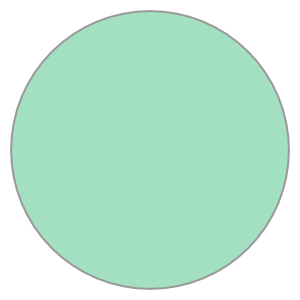

In [ ]:
nodongReach[0]

And let's combine the three buffers into a new GeoDataFrame:

In [ ]:
missileReach = gpd.GeoDataFrame({'missileType': ['Nodong', 'Taepodong 1', 'Taepodong 2'], 'maximumRange': ['1,300 km', '10,000 km', '10,000 - 15,000 km'], 'payload': ['700 kg', 'Several hundred kg', 'Several hundred kg'], 'geometry': [nodongReach[0], taepodong1reach[0], taepodong2reach[0]]}, crs='epsg:5179')

In [ ]:
missileReach.head()

,missileType,maximumRange,payload,geometry
0,Nodong,"1,300 km",700 kg,"POLYGON ((2148992.52 2116674.7, 2142732.664 19..."
1,Taepodong 1,"10,000 km",Several hundred kg,"POLYGON ((10848992.52 2116674.7, 10800839.786 ..."
2,Taepodong 2,"10,000 - 15,000 km",Several hundred kg,"POLYGON ((15848992.52 2116674.7, 15776763.42 6..."


Finally, in order to map it with Altair we need to chagne the CRS back to WGS 84.

In [ ]:
missileReach = missileReach.to_crs('epsg:4326')

In [ ]:
missileReach.head()

,missileType,maximumRange,payload,geometry
0,Nodong,"1,300 km",700 kg,"POLYGON ((140.61618 38.30948, 140.34796 37.198..."
1,Taepodong 1,"10,000 km",Several hundred kg,"POLYGON ((-161.79766 14.76786, -163.93764 11.8..."
2,Taepodong 2,"10,000 - 15,000 km",Several hundred kg,"POLYGON ((-151.53869 6.65449, -153.06344 4.633..."


In [ ]:
pyongyangGeo = pyongyangGeo.to_crs('epsg:4326')

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5,
    opacity = 0.25
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1',
    rotate=[-155, 0]
)

missileReachMap = alt.Chart(missileReach).mark_geoshape().encode(
    color=alt.Color('missileType:N', legend=alt.Legend(
        title='Type of Missile')
    ),
    order = alt.Order('missileType:N', sort='descending')
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(fill='black')

alt.layer(missileReachMap, worldMap, pyongyangMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

And just to give you an idea of how different this looks with a different projection, here's the same map using an **orthographic** projection.

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5,
    opacity = 0.25
).properties(
    width=500,
    height=500
).project(
    type='orthographic',
    rotate=[140, -40]
)

missileReachMap = alt.Chart(missileReach).mark_geoshape().encode(
    color=alt.Color('missileType:N', legend=alt.Legend(
        title='Type of Missile')
    ),
    order = alt.Order('missileType:N', sort='descending')
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(fill='black')

alt.layer(missileReachMap, worldMap, pyongyangMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
from shapely.geometry import Point

In [ ]:
xmin = -20026376.39
ymin = -9462156.72
xmax = 20026376.39
ymax = 9462156.72

In [ ]:
length = 500000
width = 500000

In [ ]:
cols = list(np.arange(xmin, xmax + width, width))
rows = list(np.arange(ymin, ymax + length, length))

In [ ]:
len(cols)

82

In [ ]:
points = []
for x in cols[:-1]:
    for y in rows[:-1]:
        points.append(Point(x,y))

In [ ]:
len(points)

3078

In [ ]:
points[0].y

-9462156.72

In [ ]:
points[10].y

-4462156.720000001

In [ ]:
grid = gpd.GeoDataFrame({'geometry':points}, crs='epsg:4087')

In [ ]:
grid.head()

,geometry
0,POINT (-20026376.39 -9462156.72)
1,POINT (-20026376.39 -8962156.72)
2,POINT (-20026376.39 -8462156.72)
3,POINT (-20026376.39 -7962156.72)
4,POINT (-20026376.39 -7462156.72)


In [ ]:
grid.to_crs('epsg:4326', inplace=True)

In [ ]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1'
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape(fill='red')

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='orthographic',
    rotate=[140, -40]
)
pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape(fill='red')

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
)
pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape(fill='red')

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
grid.to_crs('epsg:4087', inplace=True)
pyongyangGeo.to_crs('epsg:4087', inplace=True)

In [ ]:
grid['distance'] = grid.geometry.apply(lambda g: pyongyangGeo.distance(g))

In [ ]:
grid.head()

,geometry,distance
0,POINT (-20026376.39 -9462156.72),3.672036e+07
1,POINT (-20026376.39 -8962156.72),3.653528e+07
2,POINT (-20026376.39 -8462156.72),3.635614e+07
3,POINT (-20026376.39 -7962156.72),3.618302e+07
4,POINT (-20026376.39 -7462156.72),3.601601e+07


In [ ]:
grid.to_crs('epsg:4326', inplace=True)
pyongyangGeo.to_crs('epsg:4326', inplace=True)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1'
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape().encode(
    color='distance:Q'
)

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
pyongyangGeo.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
grid.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1'
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape().encode(
    color='distance:Q'
).transform_filter(
    alt.FieldLTEPredicate(field='distance', lte=13000000)
)

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='orthographic',
    rotate=[140, -40]
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape().encode(
    color='distance:Q'
).transform_filter(
    alt.FieldLTEPredicate(field='distance', lte=13000000)
)

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

Enter [Geopy](https://geopy.readthedocs.io/en/stable/index.html?highlight=distance#geopy.distance.geodesic).

In [ ]:
from geopy.distance import geodesic

In [ ]:
pyongyangGeo['latlon'] = pyongyangGeo.geometry.apply(lambda g: (g.y, g.x))

In [ ]:
pyongyangGeo.head()

,city,country,longitude,latitude,geometry,latlon
0,Pyongyang,Democratic People's Republic of Korea,125.755211,39.038431,POINT (125.75521 39.03843),"(39.03843075600298, 125.75521066310591)"


In [ ]:
grid['latlon'] = grid.geometry.apply(lambda g: (g.y, g.x))

In [ ]:
grid.head()

,geometry,distance,latlon
0,POINT (-179.9 -85),3.672036e+07,"(-85.00000002310242, -179.89999996667325)"
1,POINT (-179.9 -80.50842),3.653528e+07,"(-80.50842360250479, -179.89999996667325)"
2,POINT (-179.9 -76.01685),3.635614e+07,"(-76.01684718190717, -179.89999996667325)"
3,POINT (-179.9 -71.52527),3.618302e+07,"(-71.52527076130957, -179.89999996667325)"
4,POINT (-179.9 -67.03369),3.601601e+07,"(-67.03369434071196, -179.89999996667325)"


In [ ]:
grid['distanceGeodesic'] = grid.latlon.apply(lambda g: geodesic(pyongyangGeo.latlon, g).km)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='orthographic',
    rotate=[140, -40]
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape().encode(
    color='distanceGeodesic:Q'
).transform_filter(
    alt.FieldLTEPredicate(field='distanceGeodesic', lte=13000)
)

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1',
    rotate=[-155, 0]
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

gridMap = alt.Chart(grid).mark_geoshape().encode(
    color='distanceGeodesic:Q'
).transform_filter(
    alt.FieldLTEPredicate(field='distanceGeodesic', lte=13000)
)

alt.layer(worldMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1',
    rotate=[-155, 0]
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

missileReachMap = alt.Chart(missileReach).mark_geoshape().encode(
    color=alt.Color('missileType:N', legend=alt.Legend(
        title='Type of Missile')
    ),
    order = alt.Order('missileType:N', sort='descending')
)

gridMap = alt.Chart(grid).mark_geoshape().encode(
    color='distanceGeodesic:Q'
).transform_filter(
    alt.FieldLTEPredicate(field='distanceGeodesic', lte=13000)
)

alt.layer(worldMap + missileReachMap + pyongyangMap + gridMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
from geopy.distance import great_circle

In [ ]:
grid['distanceGreatCircle'] = grid.latlon.apply(lambda g: great_circle(pyongyangGeo.latlon, g).km)

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1',
    rotate=[-155, 0]
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(
    fill='black'
)

geodesicMap = alt.Chart(grid).mark_geoshape(fill='blue').transform_filter(
    alt.FieldLTEPredicate(field='distanceGeodesic', lte=13000)
)

greatCircleMap = alt.Chart(grid).mark_geoshape(fill='orange').transform_filter(
    alt.FieldLTEPredicate(field='distanceGreatCircle', lte=13000)
)

alt.layer(worldMap + pyongyangMap + greatCircleMap + geodesicMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

In [ ]:
alt.layer(worldMap + pyongyangMap + geodesicMap + greatCircleMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)

## Coda: Here's a crazy experiment

In [ ]:
pyongyangGeo = pyongyangGeo.to_crs('ESRI:54032')

In [ ]:
nodongReach = pyongyangGeo.buffer(1300000)
taepodong1reach = pyongyangGeo.buffer(10000000)
taepodong2reach = pyongyangGeo.buffer(15000000)

In [ ]:
missileReach = gpd.GeoDataFrame({'missileType': ['Nodong', 'Taepodong 1', 'Taepodong 2'], 'maximumRange': ['1,300 km', '10,000 km', '10,000 - 15,000 km'], 'payload': ['700 kg', 'Several hundred kg', 'Several hundred kg'], 'geometry': [nodongReach[0], taepodong1reach[0], taepodong2reach[0]]}, crs='ESRI:54032')

In [ ]:
missileReach = missileReach.to_crs('epsg:4326')
pyongyangGeo = pyongyangGeo.to_crs('epsg:4326')

In [ ]:
worldMap = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='darkgray',
    strokeWidth=0.5,
    opacity = 0.25
).properties(
    width=1000,
    height=500
).project(
    type='naturalEarth1',
    rotate=[-155, 0]
)

missileReachMap = alt.Chart(missileReach).mark_geoshape().encode(
    color=alt.Color('missileType:N', legend=alt.Legend(
        title='Type of Missile')
    ),
    order = alt.Order('missileType:N', sort='descending')
)

pyongyangMap = alt.Chart(pyongyangGeo).mark_geoshape(fill='black')

alt.layer(missileReachMap, worldMap, pyongyangMap).configure_view(strokeWidth = 0)

alt.LayerChart(...)